In [1]:
import numpy as np
from scipy.optimize import fsolve
import math
from math import sin, cos
from typing import Callable
import unittest
from matplotlib import pylab as plt
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

Графики функций

In [2]:
fig = plt.figure()
fig.set_size_inches(8, 6)
ax = plt.axes(projection='3d')
x = np.arange(-100, 100, 0.1)
y = np.arange(-100, 100, 0.1)
x, y = np.meshgrid(x, y)
z2 = x**2 - y**2 + 3*x*y**3 - 2*x**2*y**2 + 2*x - 3*y - 5
z1 = 3*y**3 - 2*x**2 + 2*x**3*y - 5*x**2*y**2 + 5
ax.plot_surface(x, y, z1)
ax.plot_surface(x, y, z2)

Один корень системы уравнений:

In [3]:
def equations(p):
    x, y = p
    return (x**2 - y**2 + 3*x*y**3 - 2*x**2*y**2 + 2*x - 3*y - 5,
            3*y**3 - 2*x**2 + 2*x**3*y - 5*x**2*y**2 + 5)

(x, y), info, ier, mesg =  fsolve(equations, (0, 0), full_output=True)
print(x, y, ier)

1.375687140379588 -0.17475798541530854 1


ier = 1, значит найденное решение верное.

Все корни системы уравнений:

In [4]:
def equations(p):
    x, y = p
    return (x**2 - y**2 + 3*x*y**3 - 2*x**2*y**2 + 2*x - 3*y - 5,
            3*y**3 - 2*x**2 + 2*x**3*y - 5*x**2*y**2 + 5)

answers = set()
for x0 in np.arange(-100, 100, 2):
    for y0 in np.arange(-100, 100, 2):
        (x, y), info, ier, mesg =  fsolve(equations, (x0, y0), full_output=True)
        if ier == 1:
            answers.add((round(x, 6), round(y, 6), ier))

print(answers)

{(2.494357, 0.708318, 1), (1.375687, -0.174758, 1), (2.217754, 0.610194, 1), (1.273302, 1.662039, 1), (-3.65308, -0.274763, 1)}


5 задание: 

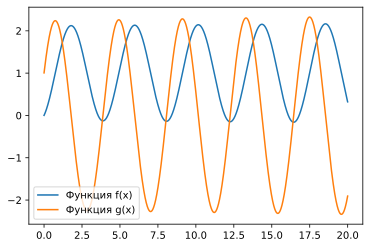

In [5]:
f = 0
g = 1
dx = 0.003
n = 0

F = []
G = []

while n < 10000:
    y = f + 0.5 * g * dx
    F.append(y)
    g = g + (2 - 2 * f) * dx
    G.append(g)
    f = y
    n += 1

X = np.arange(0, 20, 20/10000)

plt.plot(X, F, label="Функция f(x)")
plt.plot(X, G, label="Функция g(x)")
plt.legend()